In [2]:
#%matplotlib widget
%pylab inline
from matplotlib.pylab import *
datafile = "finaldata.npz"
import numpy as np

Populating the interactive namespace from numpy and matplotlib


C:\Users\Alfonso Lovati\Anaconda3\lib\site-packages\IPython\core\magics\pylab.py:160: UserWarning: pylab import has clobbered these variables: ['detrend']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [3]:
o = np.load(datafile, allow_pickle=True)
im = o["images"]
upx, upy = o["upperlimits"]
lox, loy = o["lowerlimits"]

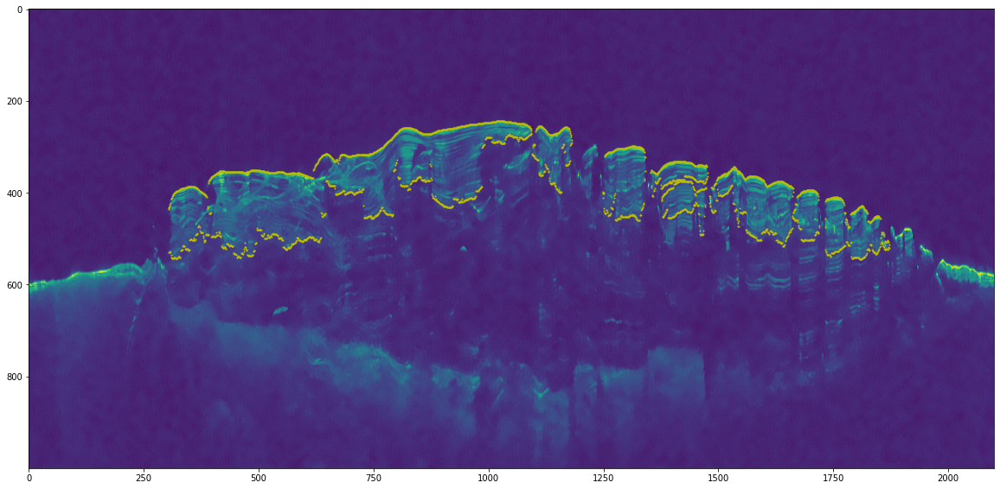

Write selected region starting column: 880
Write selected region ending column: 980


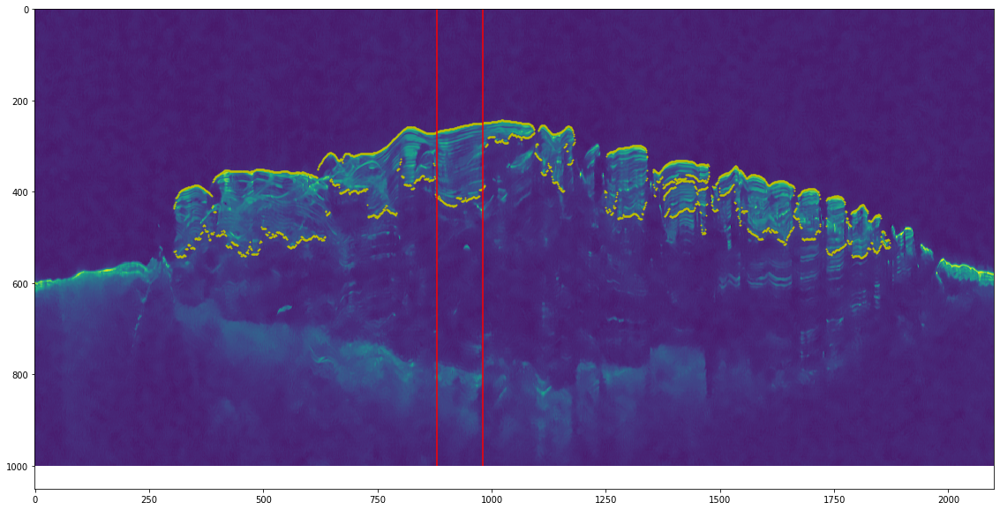

Write n if it is not well selected (else y):y


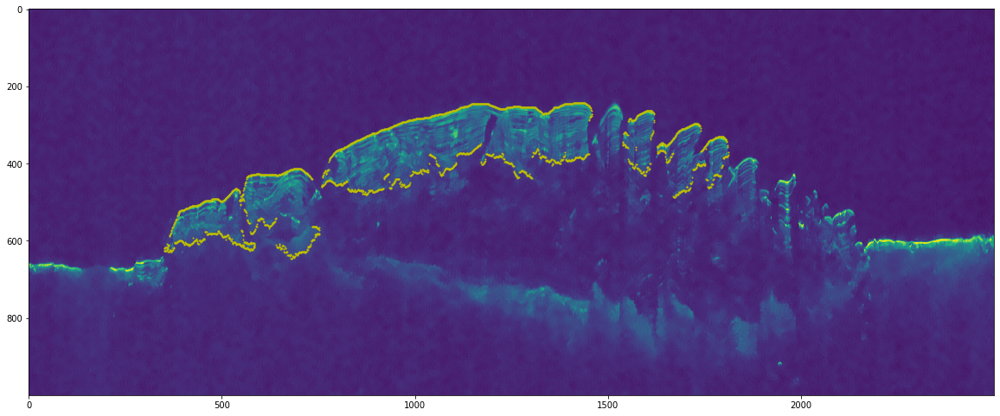

Write selected region starting column: 850
Write selected region ending column: 1180


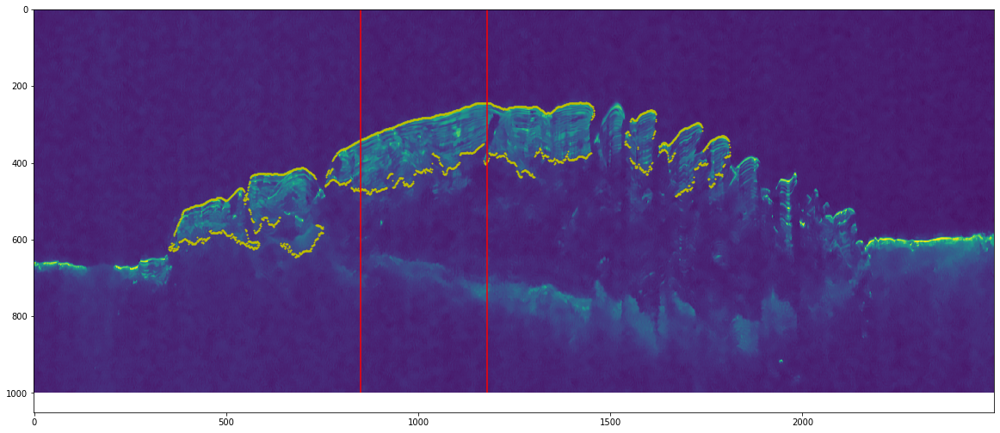

Write n if it is not well selected (else y):y


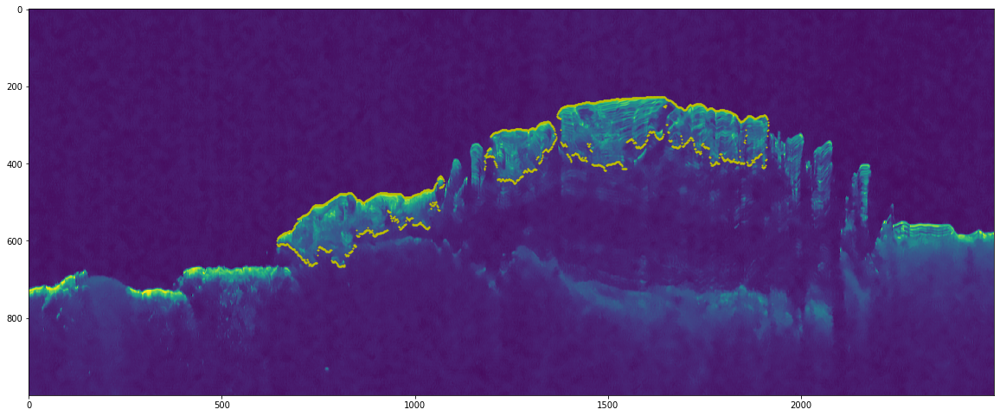

Write selected region starting column: 1380
Write selected region ending column: 1620


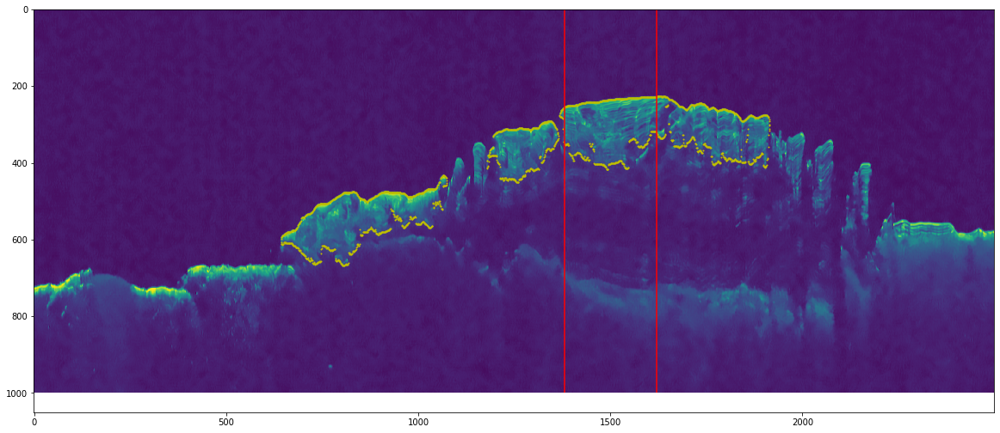

Write n if it is not well selected (else y):y


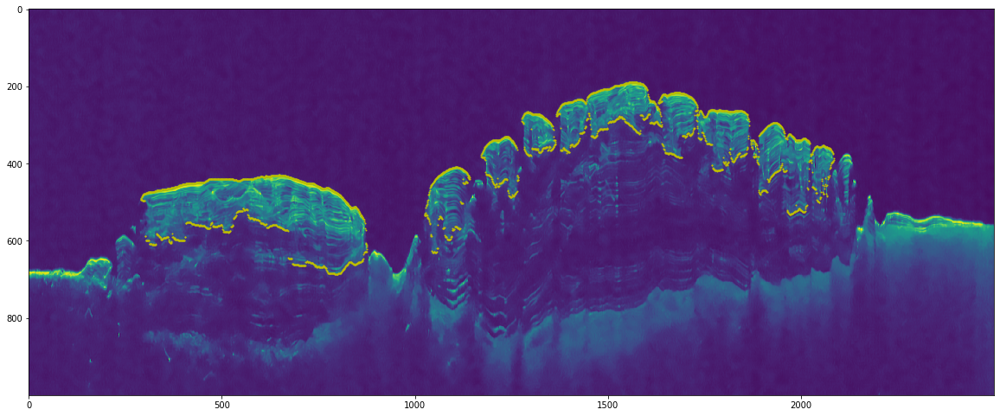

Write selected region starting column: 320
Write selected region ending column: 850


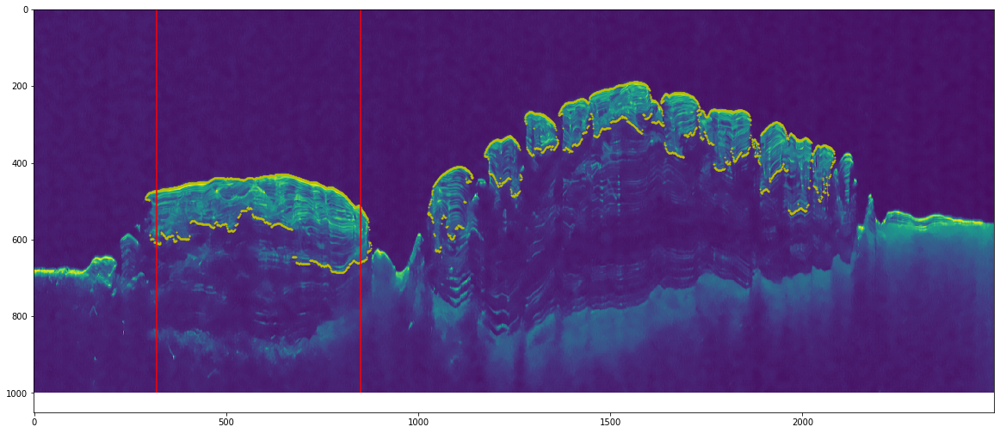

Write n if it is not well selected (else y):y


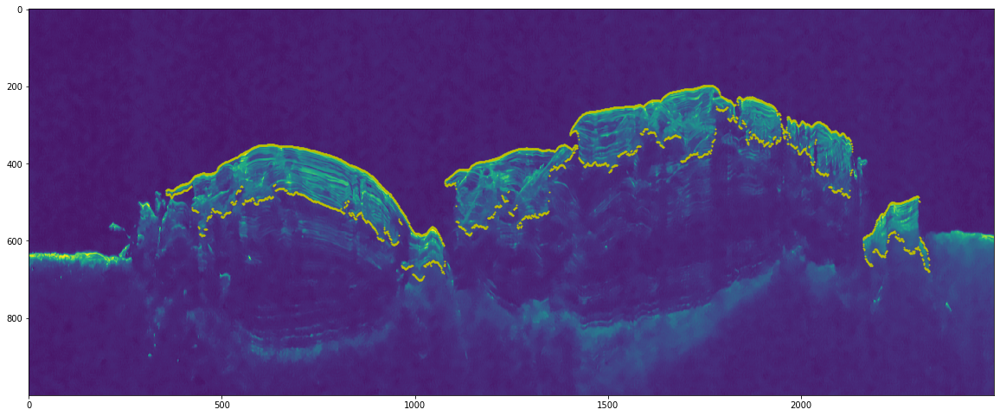

Write selected region starting column: 450
Write selected region ending column: 950


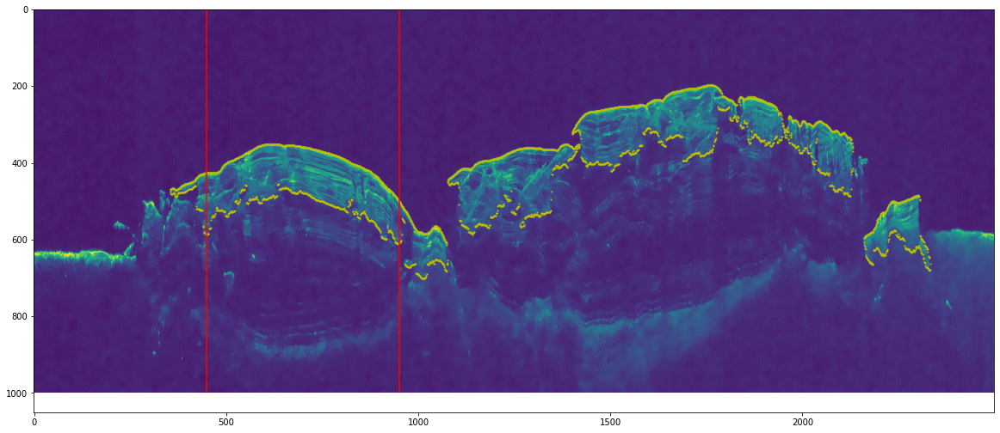

Write n if it is not well selected (else y):y


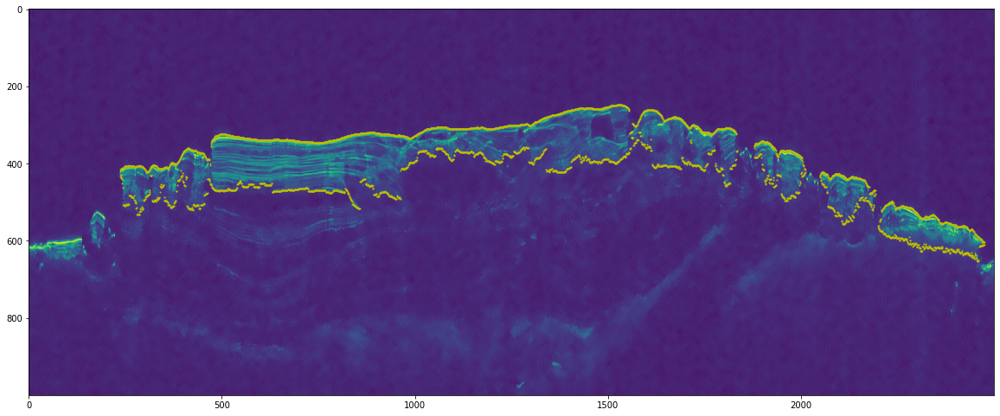

Write selected region starting column: 480
Write selected region ending column: 960


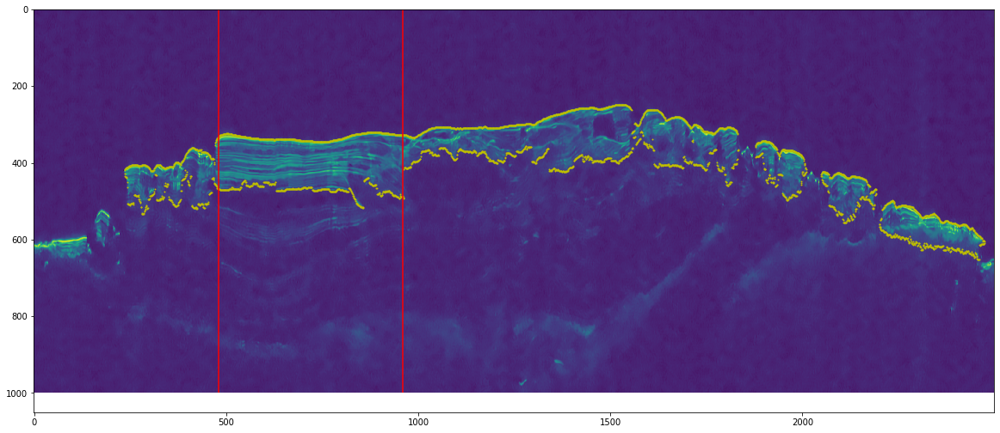

Write n if it is not well selected (else y):y


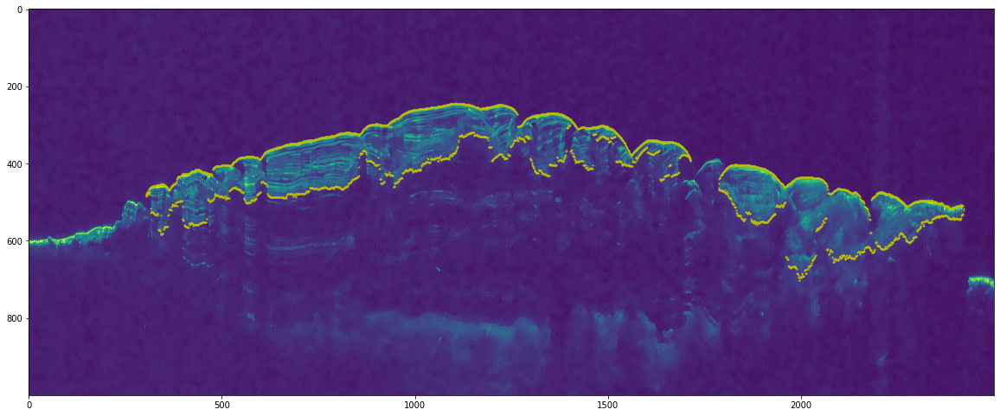

Write selected region starting column: 620
Write selected region ending column: 850


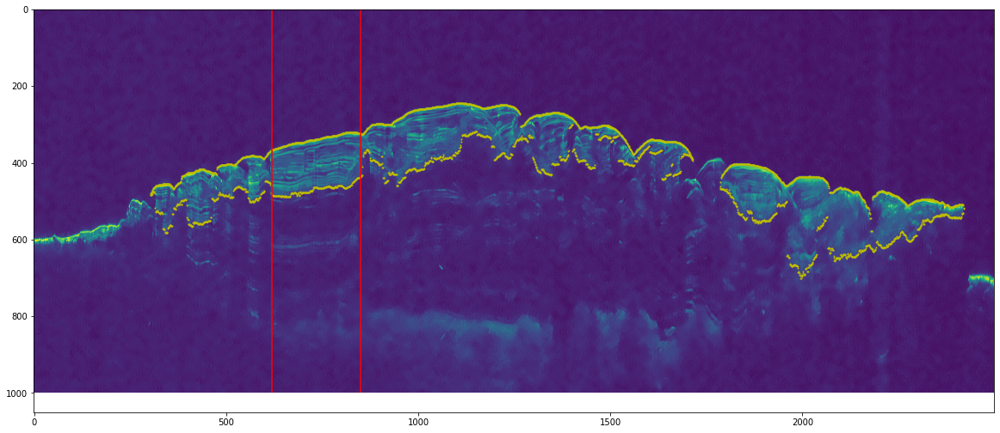

Write n if it is not well selected (else y):y


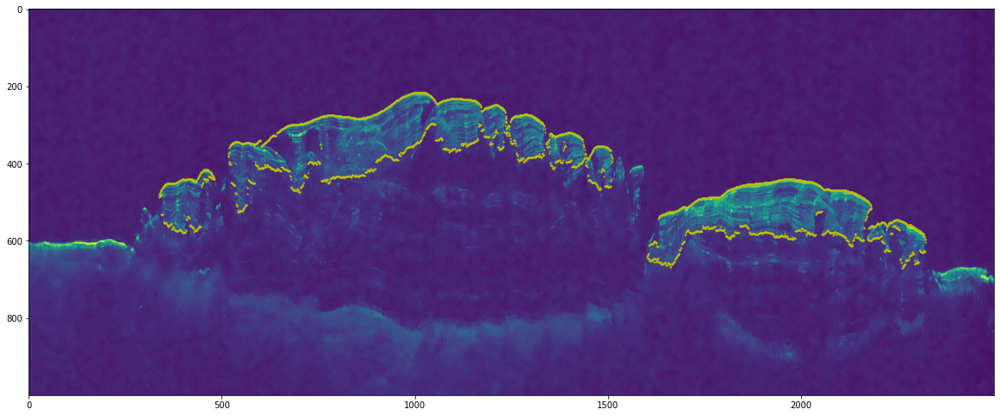

Write selected region starting column: 1700
Write selected region ending column: 2030


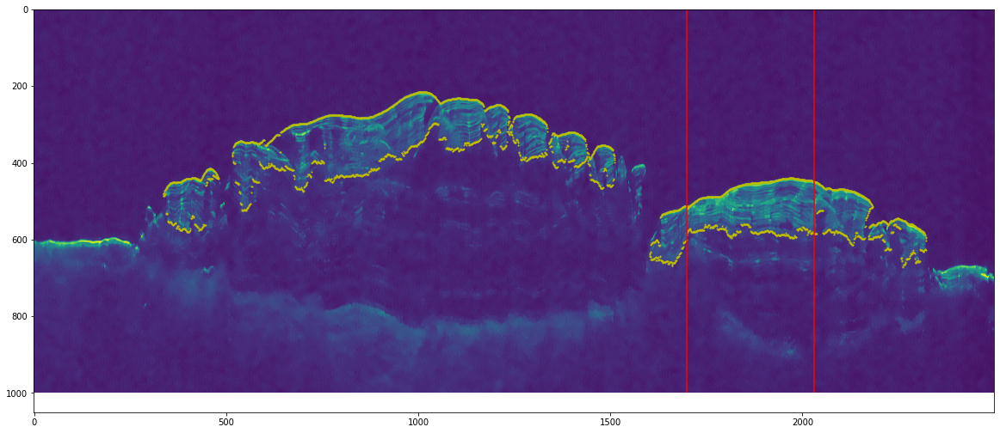

Write n if it is not well selected (else y):y


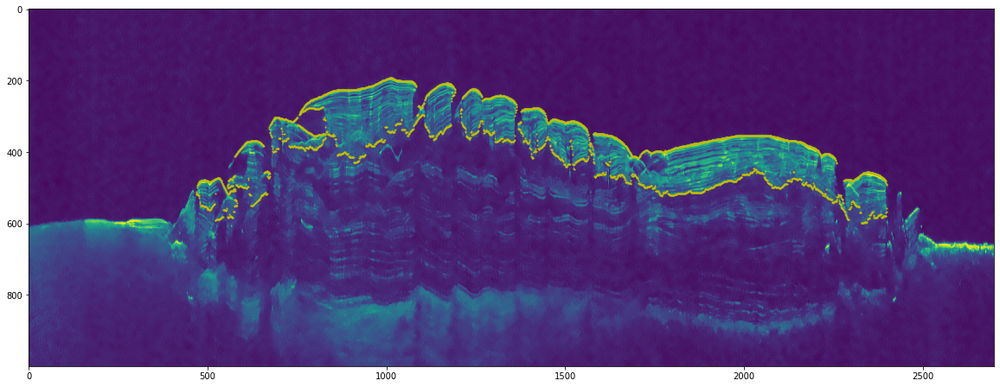

Write selected region starting column: 1770
Write selected region ending column: 2250


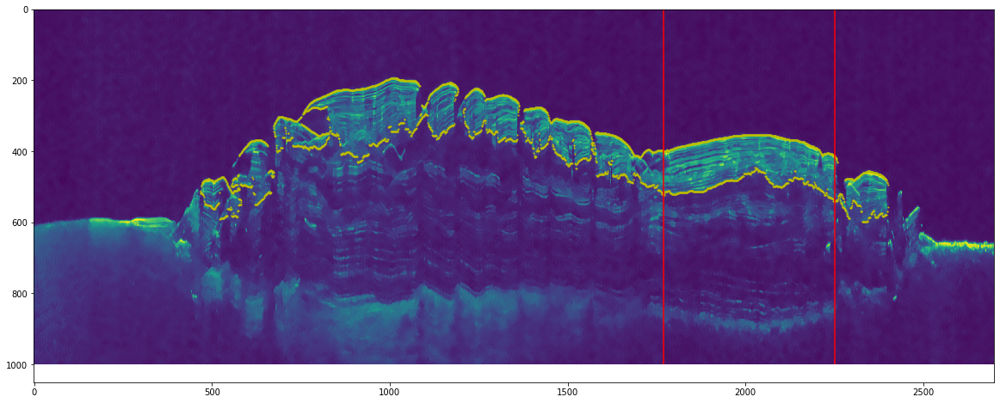

Write n if it is not well selected (else y):y


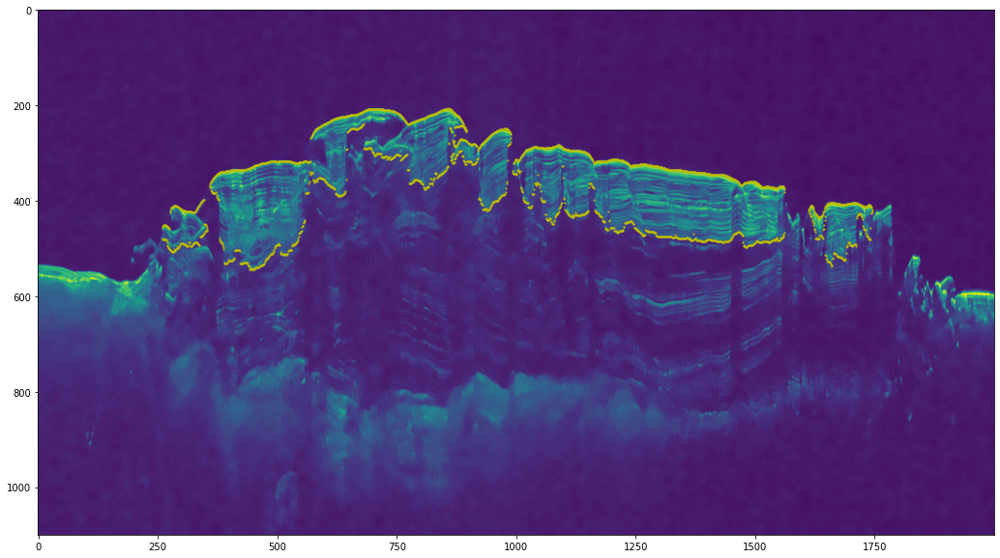

Write selected region starting column: 1165
Write selected region ending column: 1550


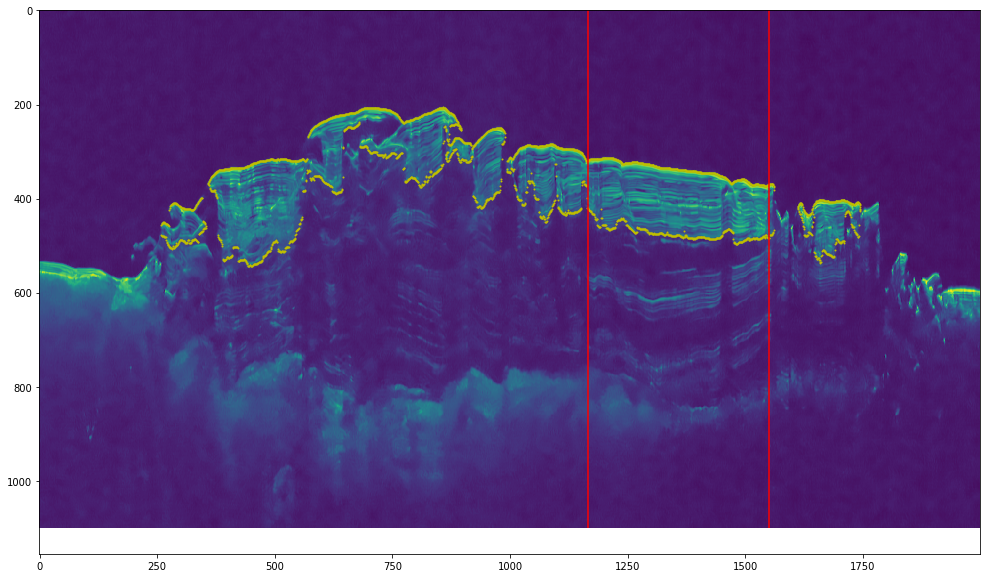

Write n if it is not well selected (else y):y


In [4]:
start = np.zeros(len(im))
end = np.zeros(len(im))
for i in range(len(im)):
    figure(figsize=(20,10))
    imshow(im[i])
    plt.scatter(upy[i],upx[i], c='y', s=1)
    plt.scatter(loy[i],lox[i], c='y', s=1)
    plt.pause(0.05)
    #plt.ion()
    start[i] = input('Write selected region starting column: ')
    end[i] = input('Write selected region ending column: ')
    figure(figsize=(20,10))
    imshow(im[i])
    plt.scatter(upy[i],upx[i], c='y', s=1)
    plt.scatter(loy[i],lox[i], c='y', s=1)
    vlines([start[i], end[i]], 0, im[i].shape[0], 'r')   
    plt.pause(0.05)
    good = input('Write n if it is not well selected (else y):')
    while good == 'n':
        start[i] = input('Write selected region starting column: ')
        end[i] = input('Write selected region ending column: ') 
        figure(figsize=(20,10))
        imshow(im[i])
        plt.scatter(upy[i],upx[i], c='y', s=1)
        plt.scatter(loy[i],lox[i], c='y', s=1)
        vlines([start[i], end[i]], 0, im[i].shape[0], 'r')   #, 0, 1690,
        plt.pause(0.05)
        good = input('Write n if it is not well selected (else y):')

In [5]:
from attr import ib, attrs
@attrs
class TimeSerie():
    signal = ib()
    start = ib()
    end = ib()
    column = ib()
    imagename = ib()

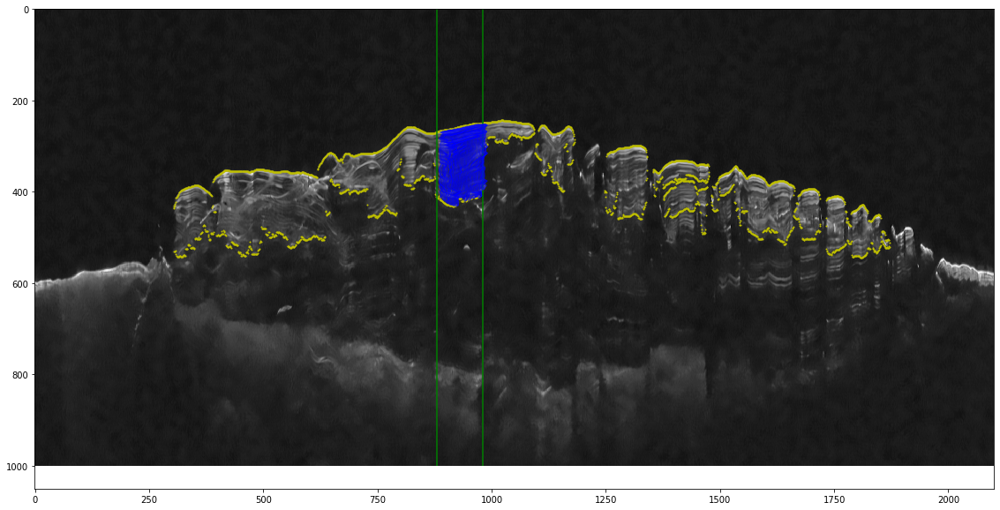

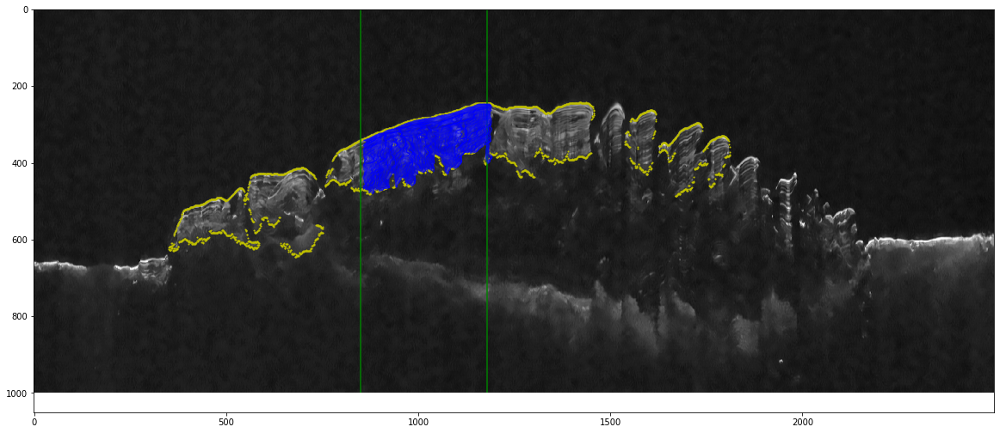

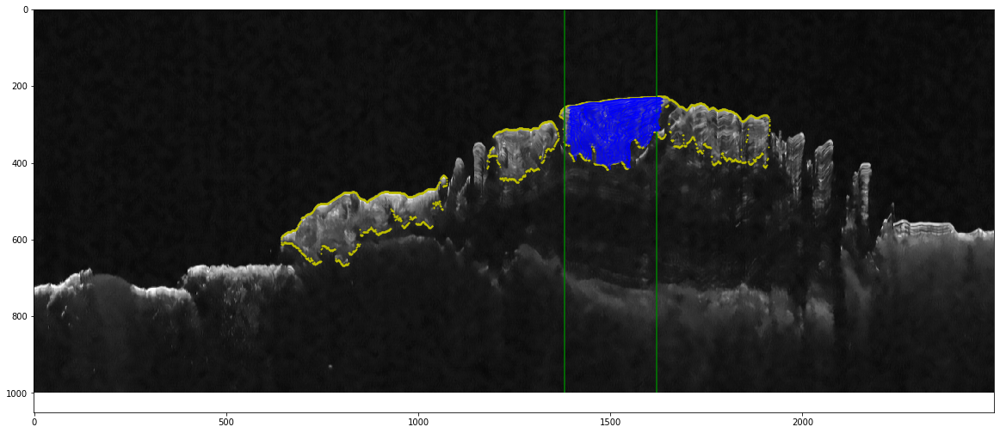

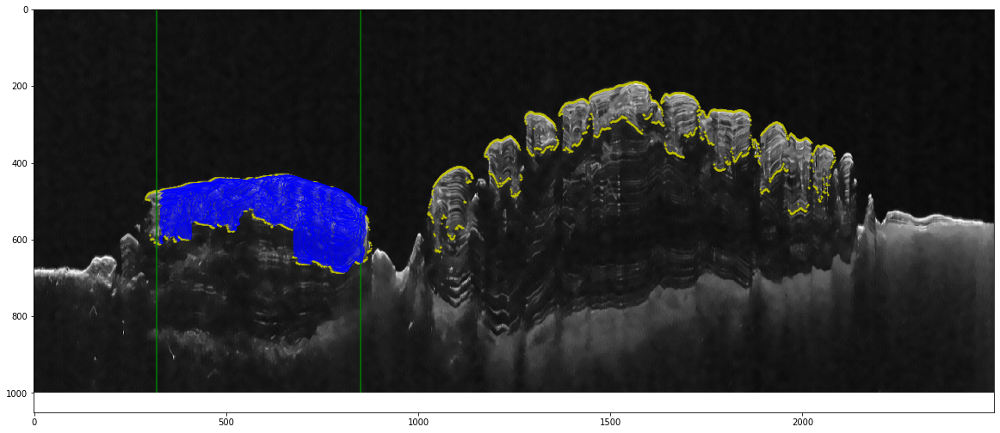

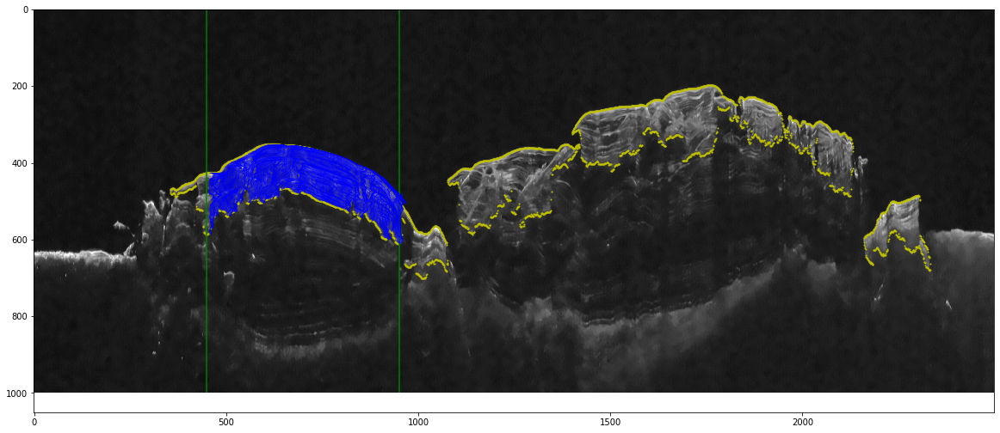

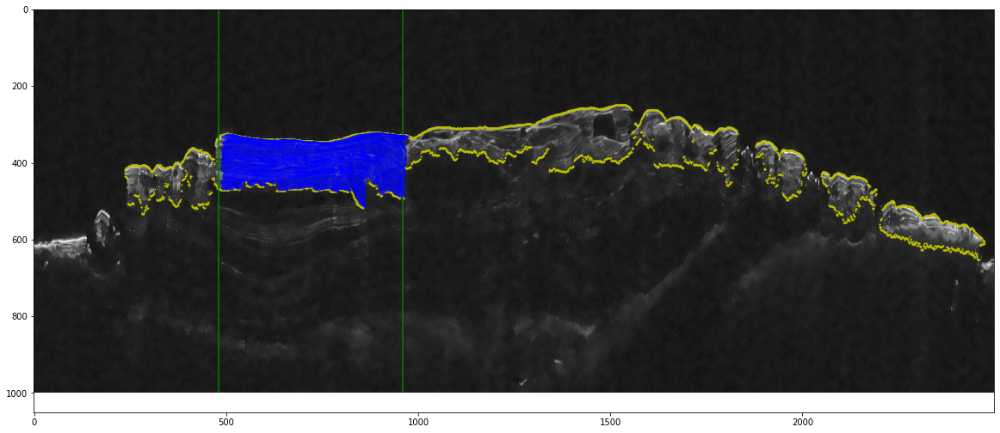

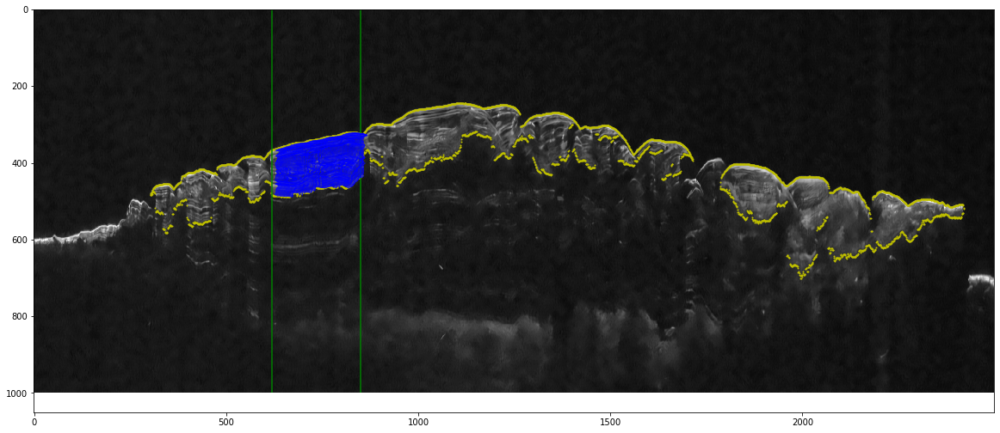

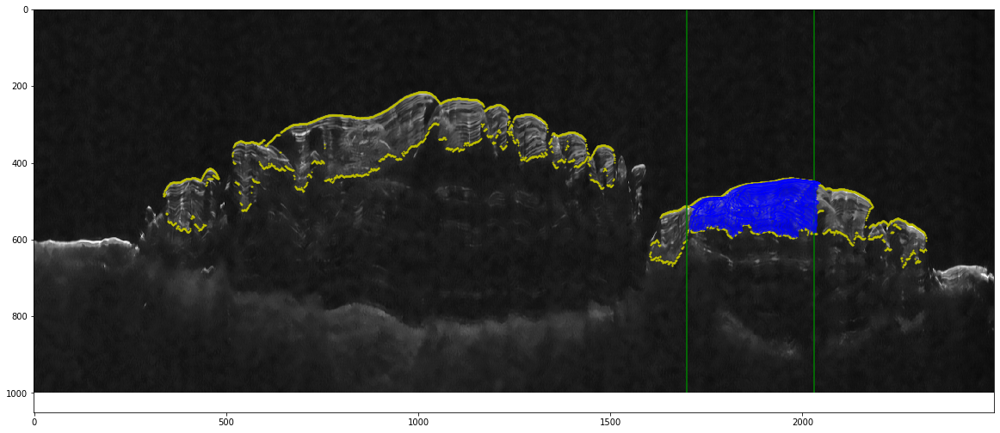

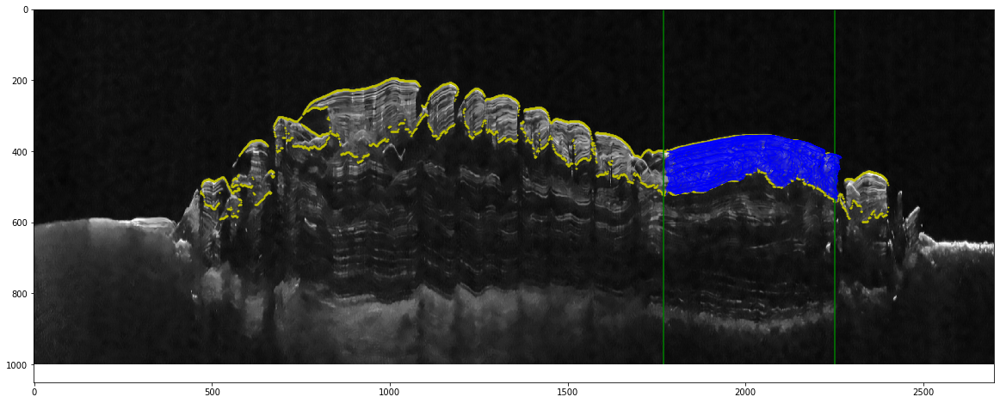

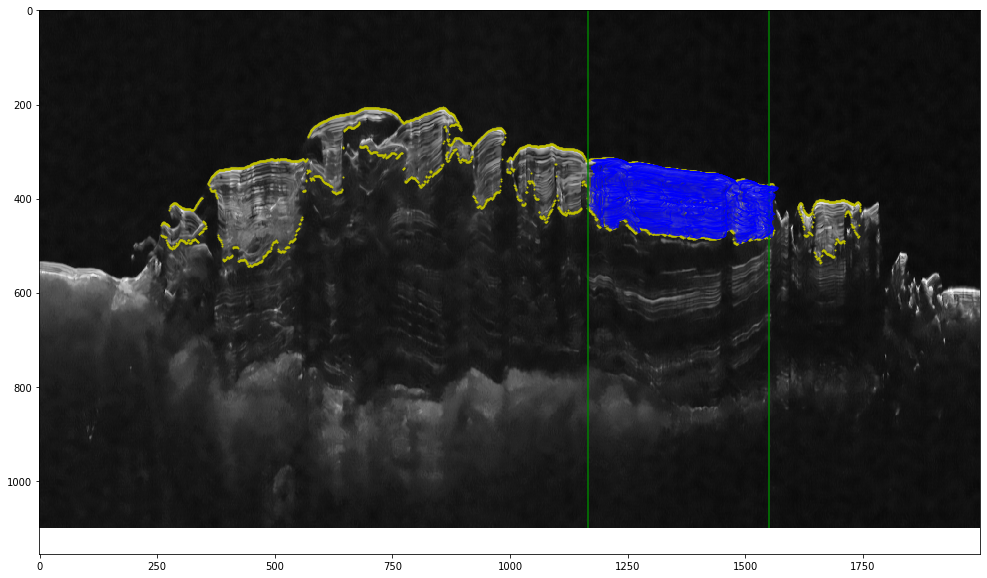

In [6]:
# now we extract the timeseries, also a plot just to be sure of what we are doing
series = []
noises = []    #taken in a region over the cap where no signal is expected

for j in range(len(im)):
    figure(figsize=(20,10))
    imshow(im[j])
    gray()

    nlength = 150 # lenght of ts for noise
    buf = 10

    for i, colid in enumerate(np.arange(start[j], end[j])):
        if colid not in upy[j]:
            continue
        
        col_pos_in_list = np.where(colid == upy[j])[0][0]
        
        astart = upx[j][col_pos_in_list] #raw value where the signal selected region begins for each column
        aend = lox[j][col_pos_in_list]

        ts = im[j].T[int(colid)][astart:aend]
    
        nstart = astart-nlength - buf  #region over the cap between the column limits start and end
        nend = astart-buf
    
        no = im[j].T[int(colid)][nstart:nend]
        plot(ts*0.1+colid, np.arange(len(ts))+astart+1, color="b", linewidth=0.5)
    
        series.append(TimeSerie(signal=ts, start=astart, end=aend, column=colid, imagename=j))
        noises.append(TimeSerie(signal=no, start=nstart, end=nend, column=colid, imagename=j))
    
# gca().set_ylim(gca().get_ylim()[::-1])

    plt.scatter(upy[j],upx[j], c='y', s=1)
    plt.scatter(loy[j],lox[j], c='y', s=1)

    vlines([start[j], end[j]], 0, im[j].shape[0], 'g')
    plt.pause(0.05)

In [29]:
for i in range(len(im)):
    figure(figsize=(10,8))
    for ts in series:
        if ts.imagename == i:

AttributeError: 'list' object has no attribute 'imagename'

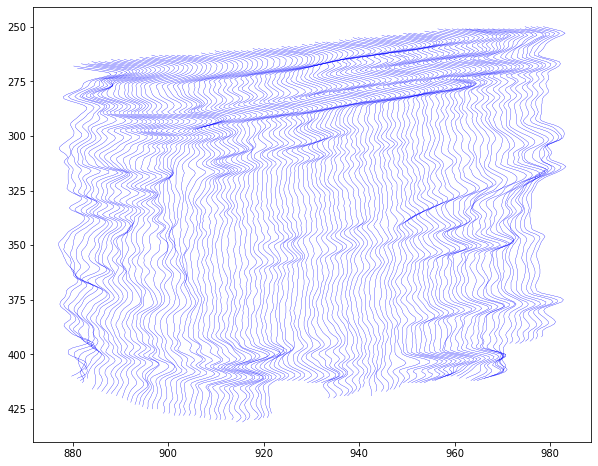

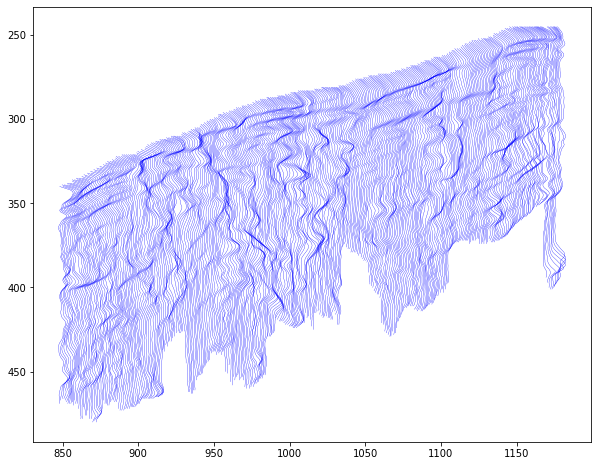

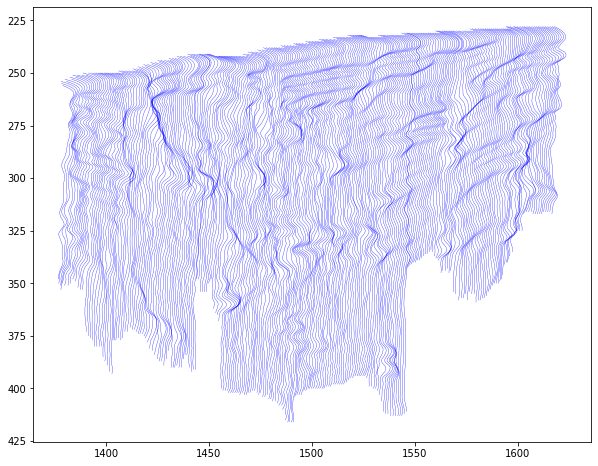

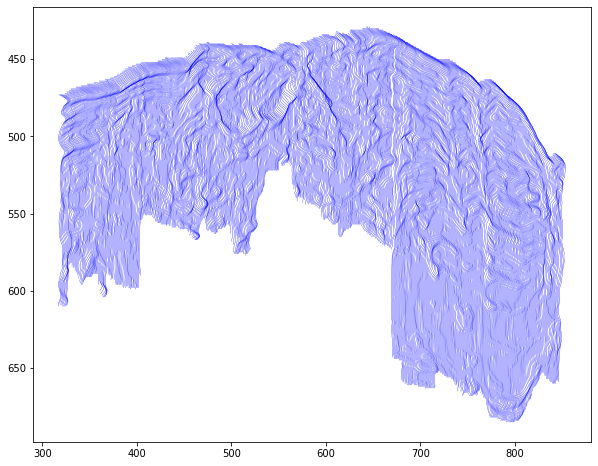

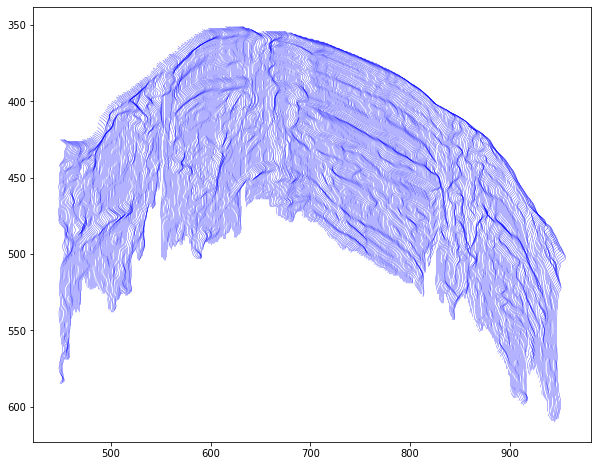

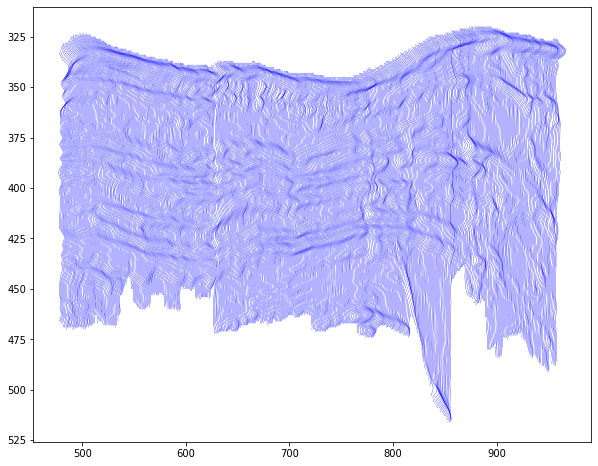

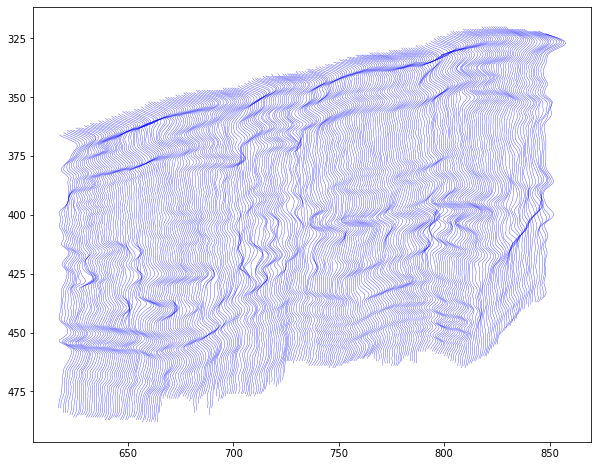

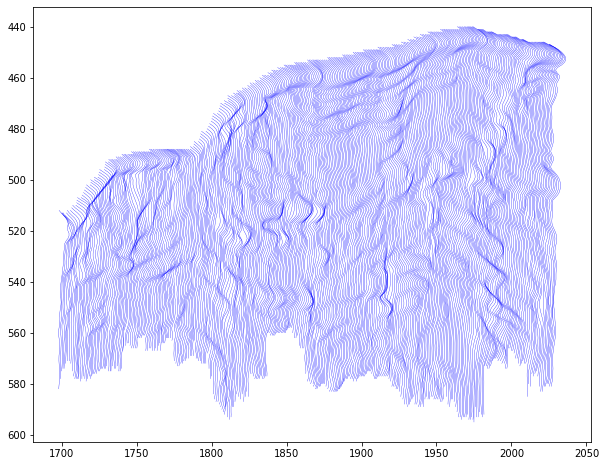

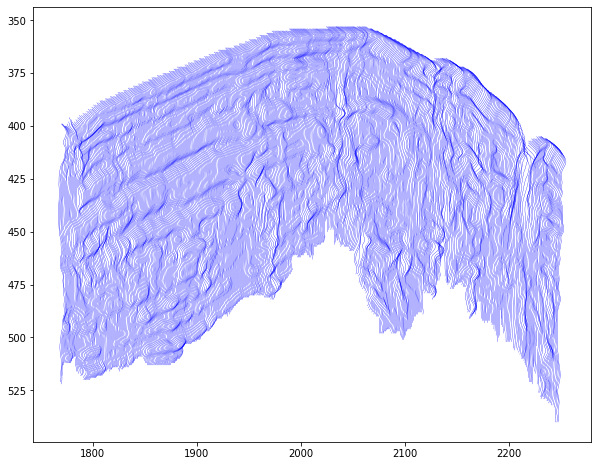

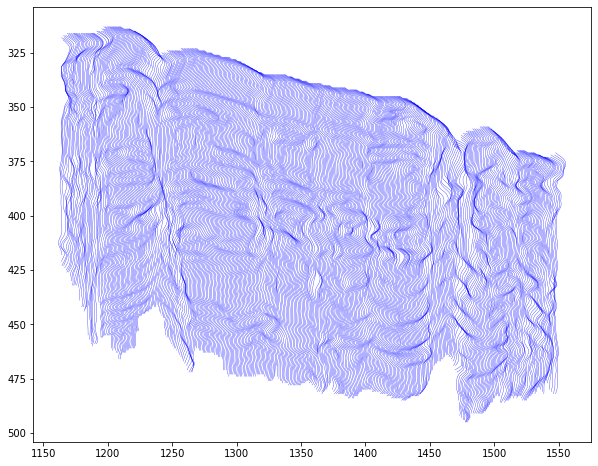

In [7]:
# test a wiggle plot, it highlights the horizons, often used in seismic data
#each curve is the time series of a column (grey value in function of pixel depht, intensity curve)

#it is necessary to shift each curve to visualize properly
#each curve is normalized

for i in range(len(im)):
    figure(figsize=(10,8))
    for ts in series:
        if ts.imagename == i:
            s = ts.signal - np.mean(ts.signal)
            s /= np.std(s)
            
            plot(s*2+ts.column, np.arange(len(s))+ts.start, color="b", linewidth=0.3)
            #gca().invert_yaxis()
            #axes.Axes.set_ylim()
    #print(max(np.arange(len(s))+ts.start))
    #print(min(np.arange(len(s))+ts.start))
    gca().invert_yaxis()
    #vlines([start[i], end[i]], max(s), min(s), 'g')
    plt.pause(0.05)

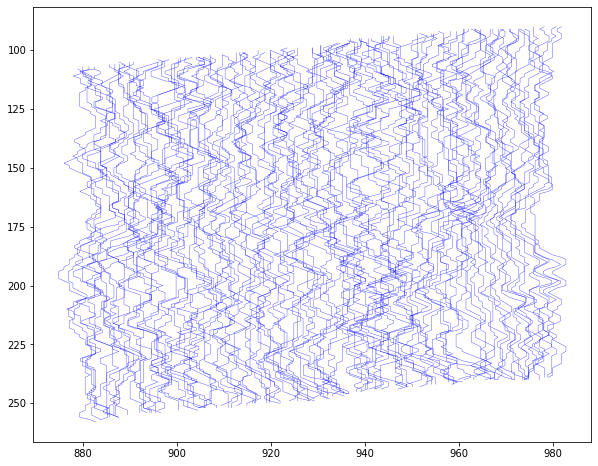

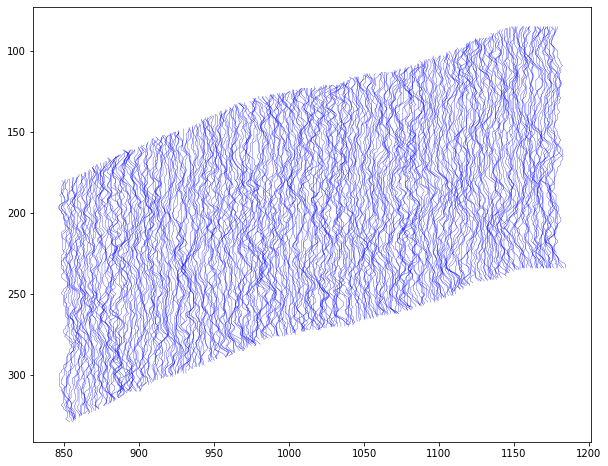

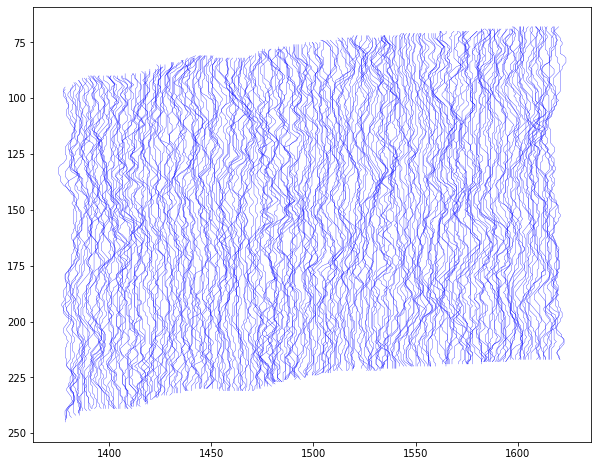

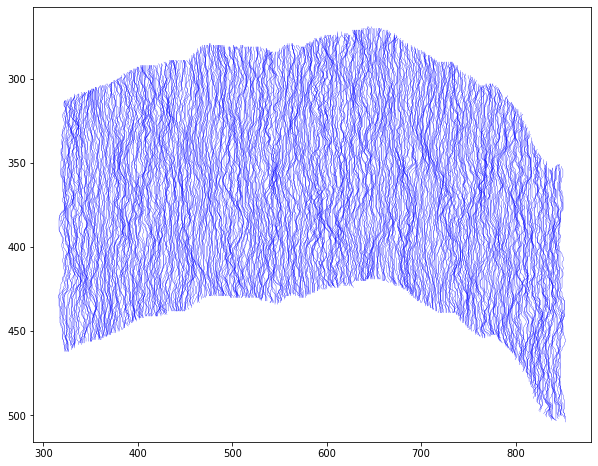

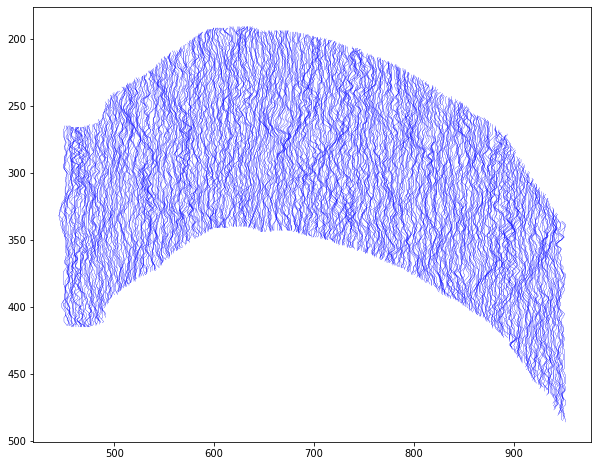

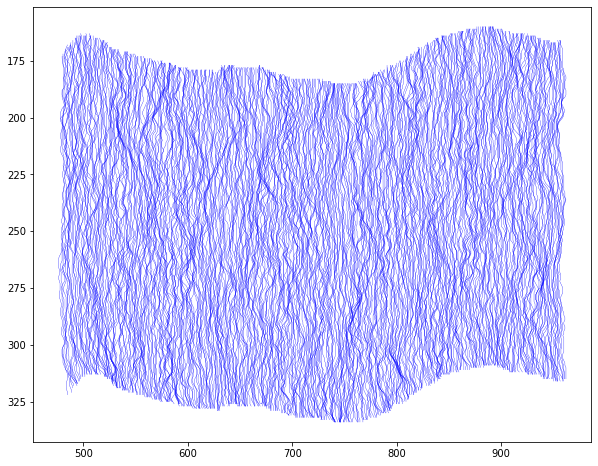

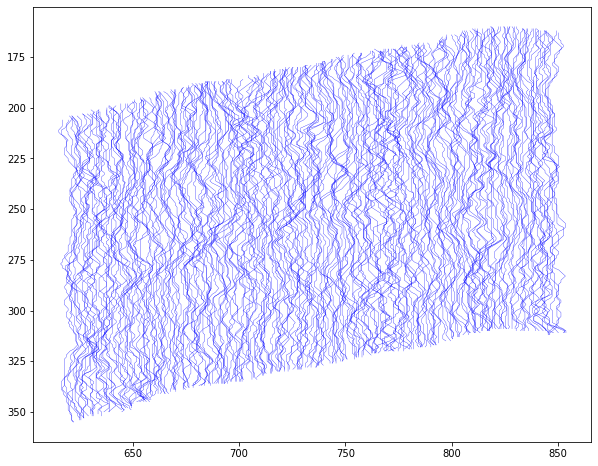

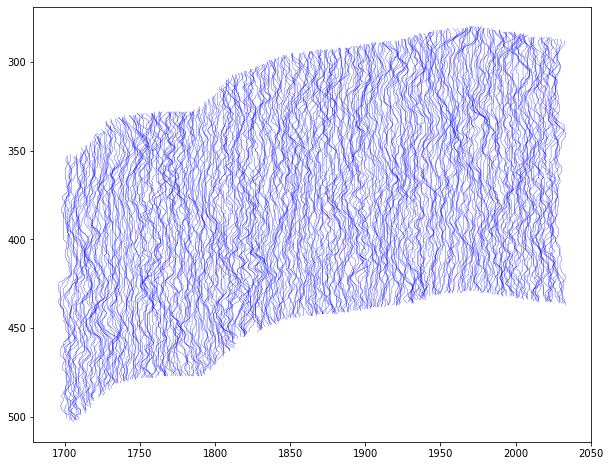

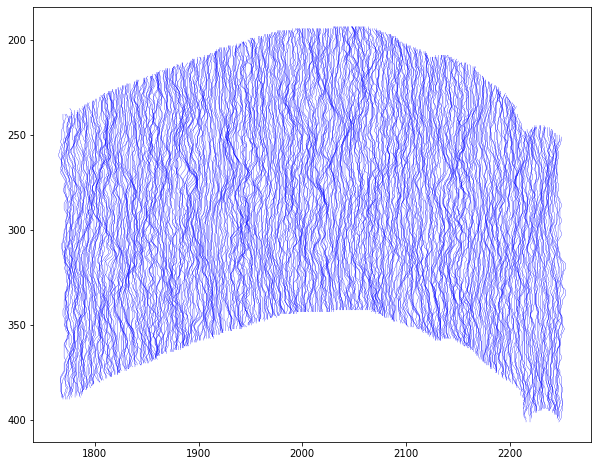

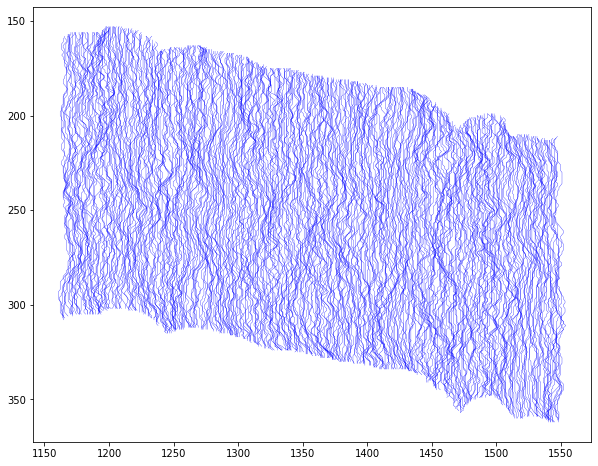

In [8]:
# test a wiggle plot of noise, it highlights the horizons, often used in seismic data, these are examples of noise

for i in range(len(im)):
    figure(figsize=(10,8))
    for ts in noises:
        if ts.imagename == i:
            s = ts.signal - np.mean(ts.signal)
            s /= np.std(s)
    
            plot(s*2+ts.column, np.arange(len(s))+ts.start, color="b", linewidth=0.3)
    
    gca().set_ylim(gca().get_ylim()[::-1])
    plt.pause(0.05)
    

#vlines([start, end], 0, 1600)

In [52]:
from scipy.signal import periodogram, get_window, detrend, find_peaks, find_peaks_cwt
padto =10000  #length to which each column will be extended with zeros

noise_f = []
avg_p_noise = []
ci95 = []

for i in range(len(im)):
    figure(figsize=(10,8))
    powers = []
    for n in noises:
        if n.imagename == i:
            w = get_window("hamming", len(n.signal))
    
            signal = detrend(n.signal, type="linear")  
            #removes the linear trend (spectral zero frequency is not interesting in this case)
    
            signal = signal*w
    
            padded = np.pad(signal, (0, padto-len(n.signal)))   #fictitious aumentation of the signal (adding zeros tho reach padto length)
            #print(type(padded))
            f, p = periodogram(padded, detrend="linear", fs =1) # fs should be set to a sampling frequency that makes sense e.g. time
            powers.append(p)
    
    noise_f.append(f)
    mm = np.row_stack(powers)
    mn = np.mean(mm, axis=0)
    #mn = np.mean(np.stack(powers[i]))
    avg_p_noise.append(mn) # the averagepower spectrum of the noise, to have a reference
    ci95.append(np.percentile(powers, 99.9, axis=0))

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

In [59]:
padto =10000  #length to which each column will be extended with zeros

signal_f = []
avg_p_signals = []

for i in range(len(im)):
    figure(figsize=(10,8))
    powers = []
    for n in series:
        if n.imagename == i:
            w = get_window("hamming", len(n.signal))
    
            signal = detrend(n.signal, type="linear")  
            #removes the linear trend (spectral zero frequency is not interesting in this case)
    
            signal = signal*w
    
            padded = np.pad(signal, (0, padto-len(n.signal)))   #fictitious aumentation of the signal (adding zeros tho reach padto length)
            #print(type(padded))
            f, p = periodogram(padded, detrend=False, fs =1) # fs should be set to a sampling frequency that makes sense e.g. time
            powers.append(p)
    
    signal_f.append(f)
    mm = np.row_stack(powers)
    mn = np.mean(mm, axis=0)
    #mn = np.mean(np.stack(powers[i]))
    avg_p_signals.append(mn) # the averagepower spectrum of the noise, to have a reference

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

In [60]:
def plot_peaks(freqs, power):
    peaks = find_peaks(power)[0]
    tt = ['{:6.2f}'.format(1/val) for val in freqs[peaks]]

    for s, p, t in zip(freqs[peaks], power[peaks], tt):
        text(s,p,t)
        
    return peaks, tt

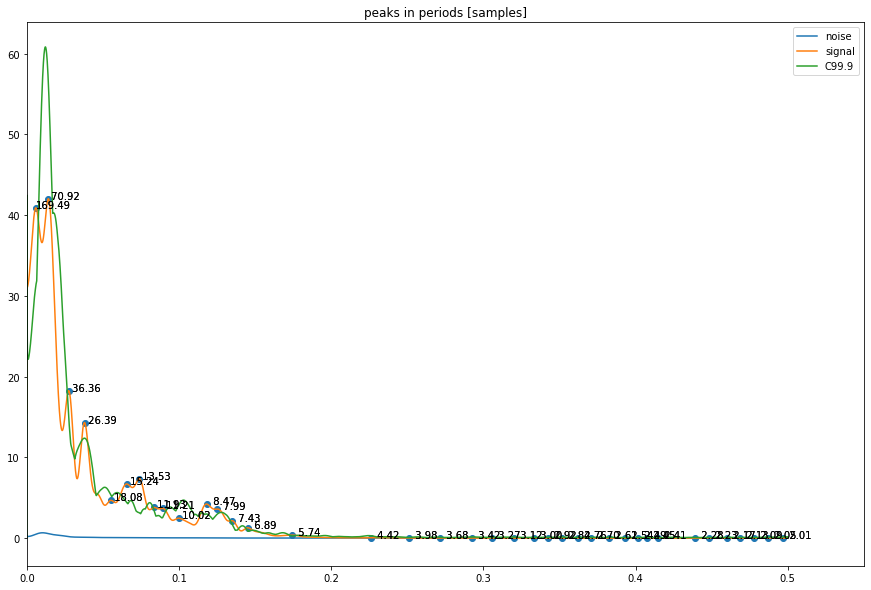

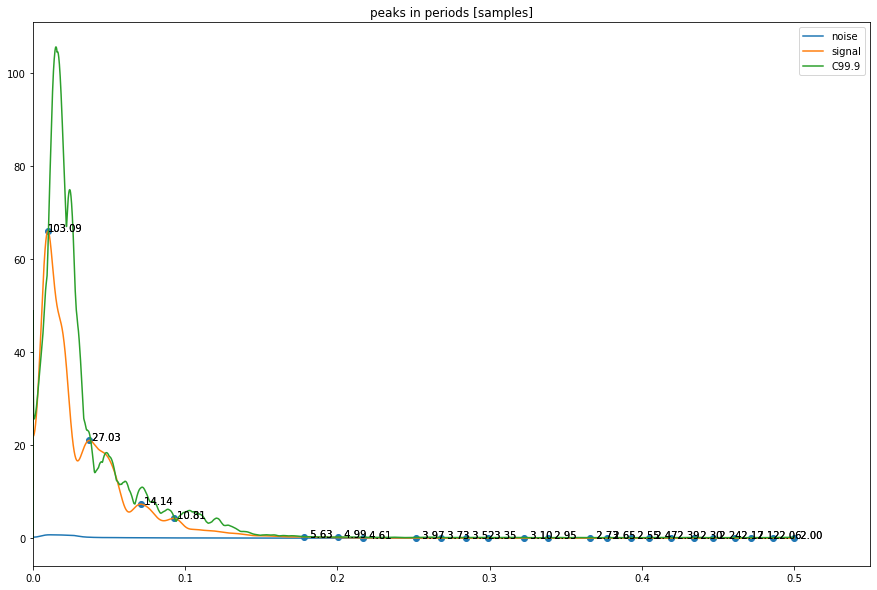

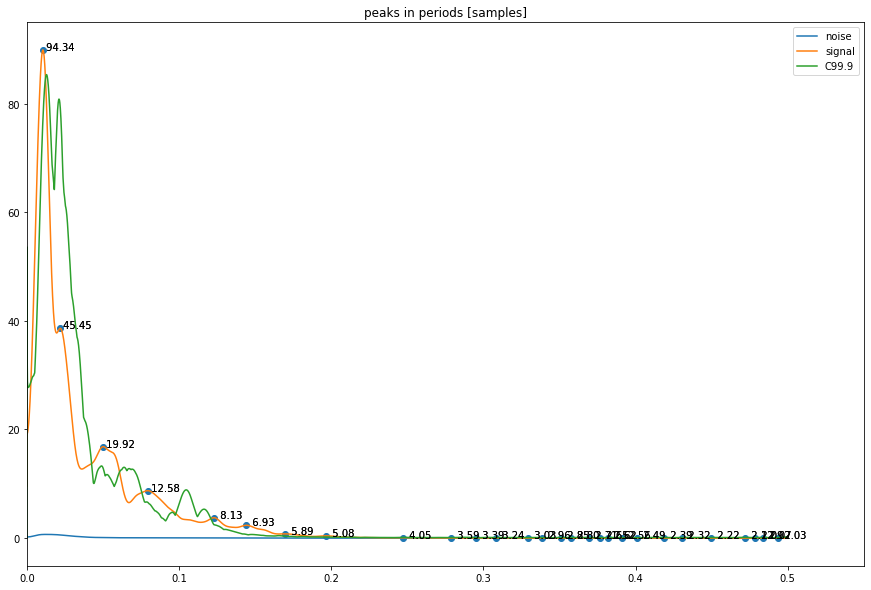

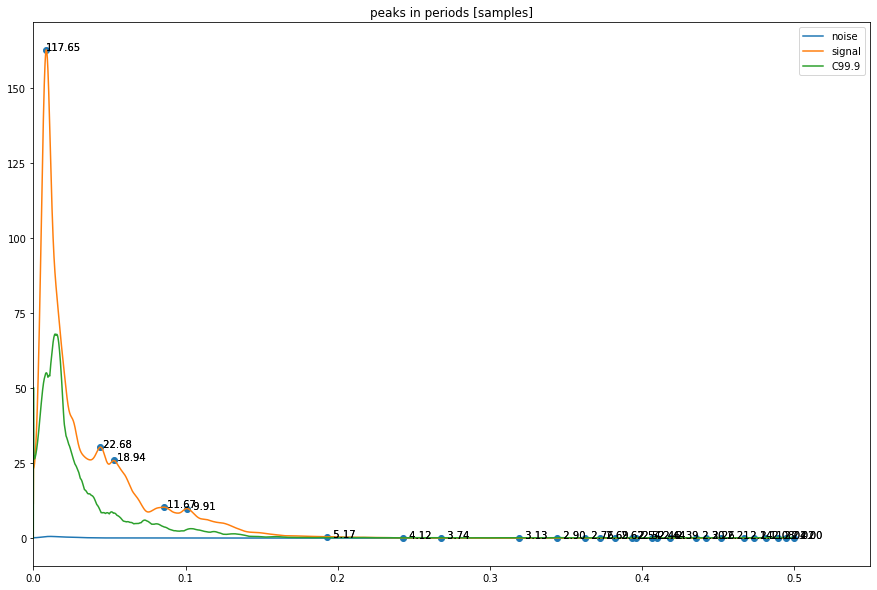

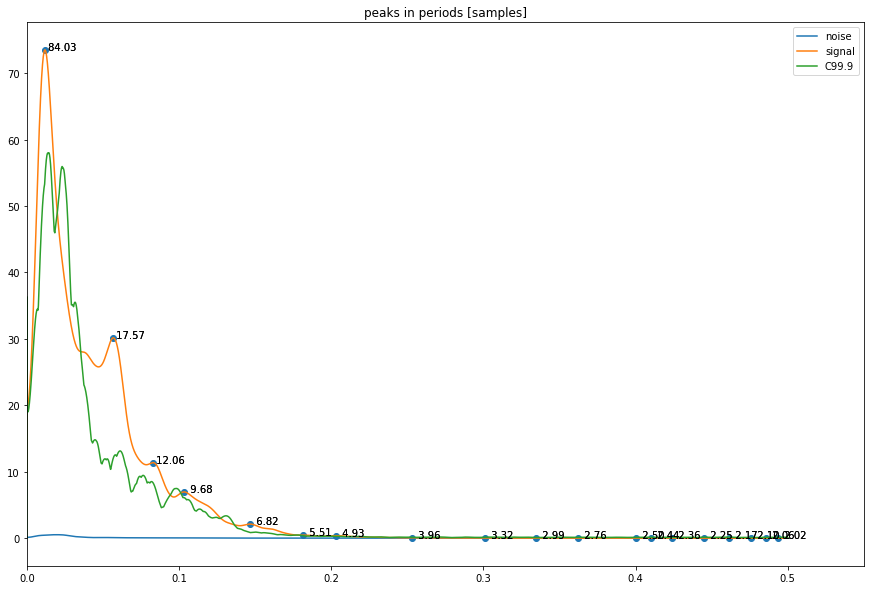

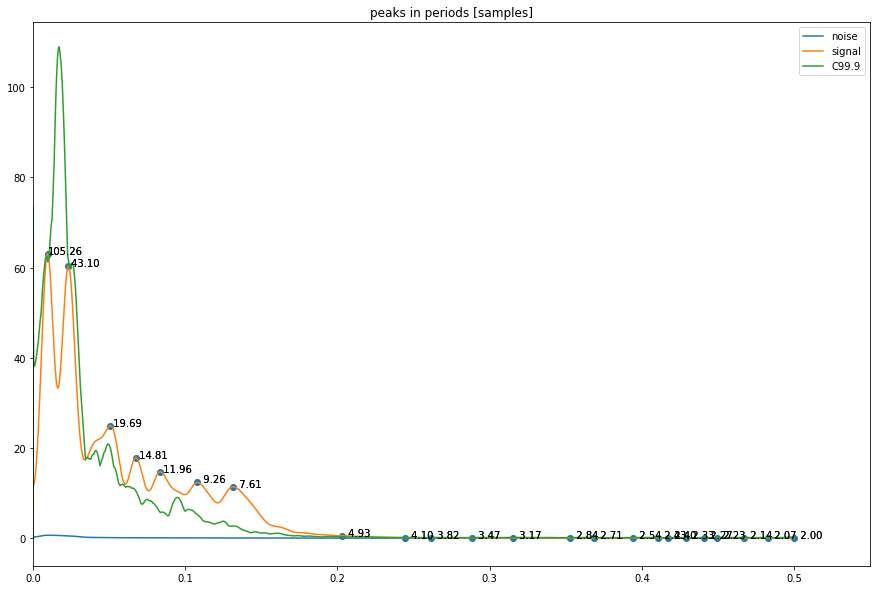

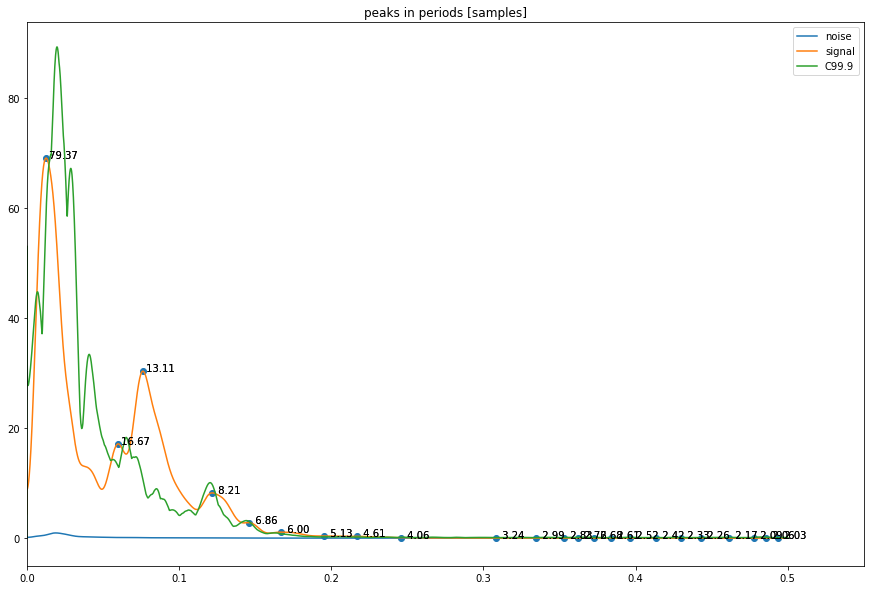

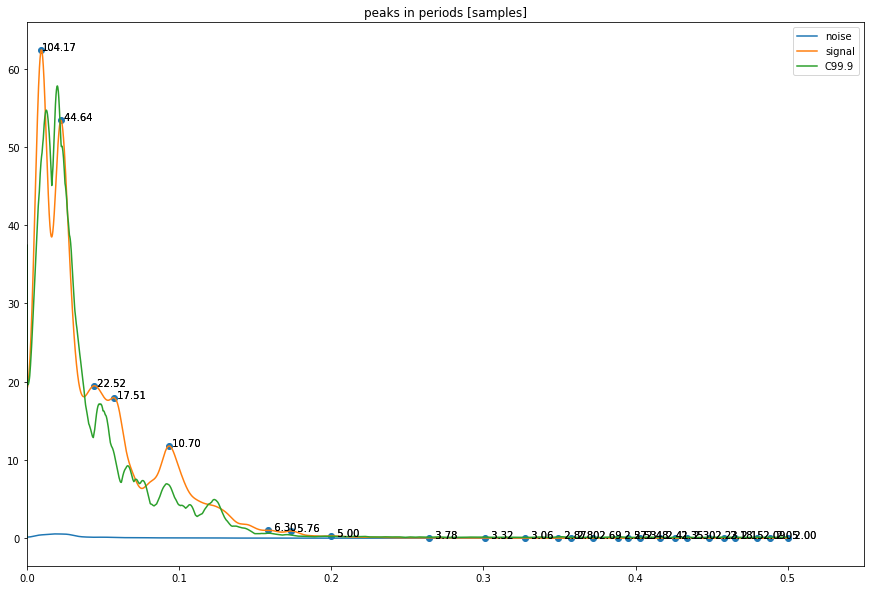

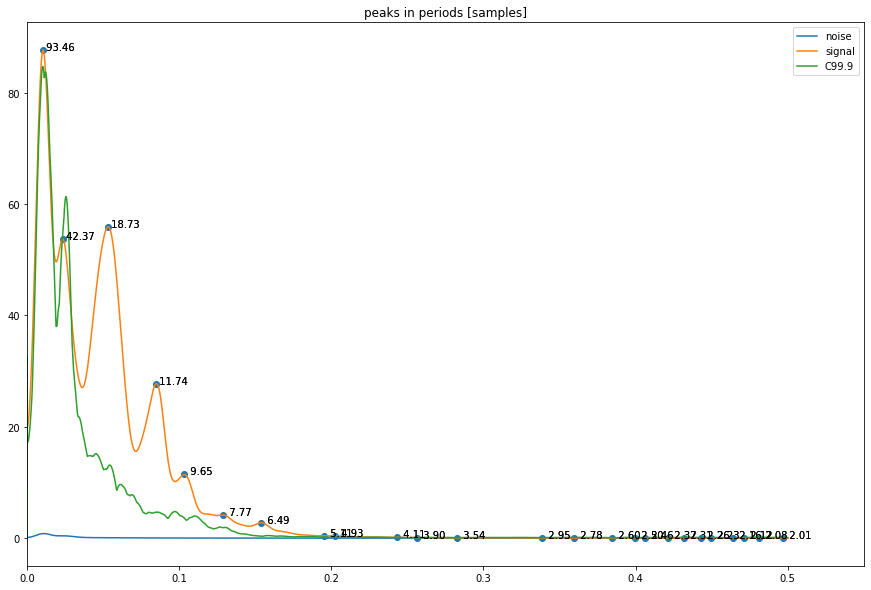

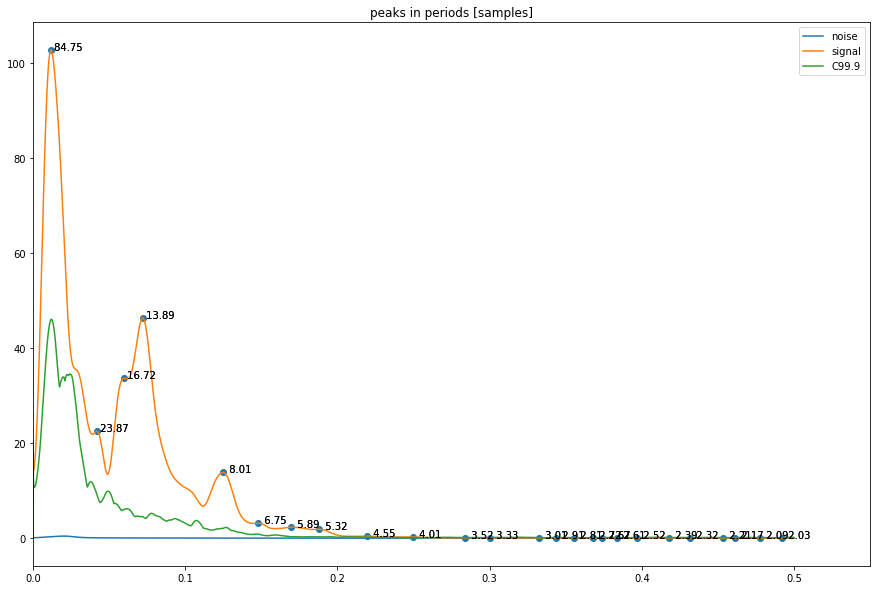

In [64]:
for i in range(len(im)):
    figure(figsize=(15,10))
    plot(noise_f[i], avg_p_noise[i], label="noise")
    plot(signal_f[i], avg_p_signals[i], label="signal")
    plot(noise_f[i], ci95[i]*20, label="C99.9")

    peaks = plot_peaks(signal_f[i], avg_p_signals[i])[0]
    tt = plot_peaks(signal_f[i], avg_p_signals[i])[1]

    scatter(signal_f[i][peaks], avg_p_signals[i][peaks])
    
    title("peaks in periods [samples]")
    legend()
    xlim(0, 0.55)
    plt.pause(0.05)